In [2]:
import torch
import pandas as pd
import numpy as np
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from PIL import Image

In [4]:
class preLearnedFungaV1(nn.Module):
    def __init__(self):
        super(preLearnedFungaV1, self).__init__()
        self.name = "fungaV1"
        #added anther convolution channel before fc layers
        self.conv1 = nn.Conv2d(256, 128, 3, 1, 1)
        self.fc1 = nn.Linear(128*6*6, 256)
        self.fc2 = nn.Linear(256, 128)
        self.fc3 = nn.Linear(128, n)

        #dropout implementation
        self.dropout1 = nn.Dropout(0.1)
        self.dropout2 = nn.Dropout(0.1)
        self.dropout3 = nn.Dropout(0.1)
        self.dropout4 = nn.Dropout(0.1)

    def forward(self, x):
        x = self.conv1(x)
        x = F.relu(x)
        x = self.dropout1(x)
        x = x.view(x.size(0), -1)

        #FC layers
        x = self.dropout2(x)
        x = F.relu(self.fc1(x))
        
        x = self.dropout3(x)
        x = F.relu(self.fc2(x))

        x = self.dropout4(x)
        x = self.fc3(x)
        x = x.squeeze(1)  
        return x

In [9]:
def get_model_name(name, batch_size, lr, epoch):
    path = "modelStorage/model_{0}_bs{1}_lr{2}_epoch{3}".format(name, batch_size, lr, epoch)
    return path

Best Model: 

In [7]:
BATCH_SIZE = 32
LEARNING_RATE = 0.0003
BEST_EPOCH = 110
n = 10

In [10]:
bestNet = preLearnedFungaV1()
model_path = get_model_name("fungaV1", batch_size=BATCH_SIZE, lr=LEARNING_RATE, epoch=BEST_EPOCH)
state = torch.load(model_path)
bestNet.load_state_dict(state)

<All keys matched successfully>

In [12]:
#Take the first image from testing 
df_test = pd.read_csv("../data/set_test.csv")
grouped_testing = df_test.groupby('Genus')['Path'].apply(list).to_dict()
mapping_testing = {key: np.array(value) for key, value in grouped_testing.items()}


#Choose first Key
firstKey = "Cookeina tricholoma"
#Choose the first image from key
firstImage = mapping_testing[firstKey][0]

In [13]:
import matplotlib.pyplot as plt

Cookeina tricholoma



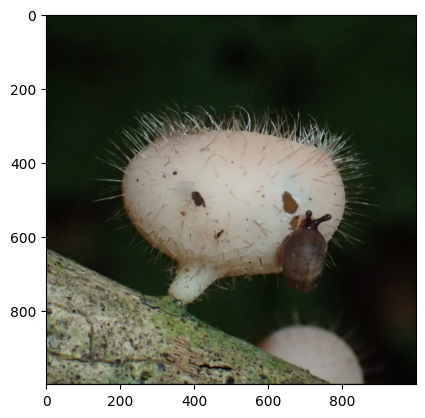

In [14]:
print(firstKey)
print()
img = plt.imread(firstImage) 
plt.imshow(img) 
plt.show()  

In [15]:
#FROM transferLearningTensor.ipynb

from torch.utils.data import TensorDataset
from torchvision import transforms
transform = transforms.Compose([transforms.ToTensor(), transforms.Resize((224,224))])
import torchvision.models
alexnet = torchvision.models.alexnet(pretrained=True)

c:\Users\eric7\AppData\Local\Programs\Python\Python312\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\eric7\AppData\Local\Programs\Python\Python312\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [17]:
featureExtraction = alexnet.features(transform(Image.open(firstImage)))

In [19]:
featureExtraction.shape

torch.Size([256, 6, 6])

In [21]:
bestNet.eval()
with torch.no_grad():
    output = bestNet(featureExtraction.unsqueeze(0))
print(output)

tensor([[14.4878,  0.5513,  2.5745, -3.3065, -1.5902, -7.0170,  3.3682, -6.4240,
         -2.9283,  0.3624]])


In [23]:
modelPrediction = torch.max(output, 1)
print(modelPrediction)

torch.return_types.max(
values=tensor([14.4878]),
indices=tensor([0]))


Load up the conversion dictionary

In [25]:
import pickle

with open('mappingStrToInt.pkl', 'rb') as file:
    loaded_dict = pickle.load(file)

print(loaded_dict)

{0: [tensor([[[0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.6760, 0.6760, 0.7666, 0.7666, 0.0000],
         [0.0000, 1.8456, 1.9450, 2.5394, 2.5268, 0.0000],
         [0.0000, 1.8456, 3.3494, 3.3494, 2.5268, 0.0000],
         [0.0000, 1.3519, 1.9819, 1.9819, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000]],

        [[0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000]],

        [[0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.000

In [26]:
index_to_find = 0  # Replace with your integer index
if index_to_find in loaded_dict:
    corresponding_value = loaded_dict[index_to_find]
    print(f'The corresponding value for index {index_to_find} is: {corresponding_value}')
else:
    print(f'Index {index_to_find} not found in the dictionary')

The corresponding value for index 0 is: [tensor([[[0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.6760, 0.6760, 0.7666, 0.7666, 0.0000],
         [0.0000, 1.8456, 1.9450, 2.5394, 2.5268, 0.0000],
         [0.0000, 1.8456, 3.3494, 3.3494, 2.5268, 0.0000],
         [0.0000, 1.3519, 1.9819, 1.9819, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000]],

        [[0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000]],

        [[0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0